In [ ]:
import torch
torch.backends.cudnn.benchmark = True


# Probar preprocesamiento

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
import random

def reducir_ruido_sal_pimienta(imagen, umbral_deteccion=0.01, tamano_kernel=3):
    """
    Aplica filtro mediana solo si se detecta suficiente ruido sal y pimienta
    
    Args:
        imagen: Imagen de entrada (BGR)
        umbral_deteccion: Porcentaje mínimo de píxeles extremos para considerar que hay ruido
        tamano_kernel: Tamaño del kernel para el filtro mediana (3 o 5 recomendado)
    
    Returns:
        Imagen con ruido reducido o imagen original si no se detecta suficiente ruido
    """
    # Convertir a escala de grises para análisis
    gris = cv2.cvtColor(imagen, cv2.COLOR_BGR2GRAY) if len(imagen.shape) > 2 else imagen.copy()
    
    # Detectar píxeles muy oscuros y muy brillantes (potencial ruido s&p)
    muy_oscuros = np.sum(gris < 30) / (gris.shape[0] * gris.shape[1])
    muy_brillantes = np.sum(gris > 225) / (gris.shape[0] * gris.shape[1])
    
    # Si hay suficientes píxeles extremos, aplicar filtro mediana
    if muy_oscuros + muy_brillantes > umbral_deteccion:
        if len(imagen.shape) > 2:  # Imagen a color
            resultado = cv2.medianBlur(imagen, tamano_kernel)
        else:  # Imagen en escala de grises
            resultado = cv2.medianBlur(imagen, tamano_kernel)
        return resultado, True
    
    return imagen, False

def mejorar_contraste_nubes(imagen, clip_limit=2.0, tile_grid_size=(8, 8)):
    """
    Mejora el contraste en imágenes con nubes mediante CLAHE
    
    Args:
        imagen: Imagen de entrada (BGR)
        clip_limit: Límite de recorte para CLAHE
        tile_grid_size: Tamaño de la cuadrícula para CLAHE
    
    Returns:
        Imagen con contraste mejorado
    """
    # Convertir a LAB para aplicar CLAHE solo en el canal L
    lab = cv2.cvtColor(imagen, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    
    # Aplicar CLAHE al canal L (luminosidad)
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)
    l_clahe = clahe.apply(l)
    
    # Combinar los canales de nuevo
    lab_clahe = cv2.merge((l_clahe, a, b))
    
    # Convertir de nuevo a BGR
    imagen_mejorada = cv2.cvtColor(lab_clahe, cv2.COLOR_LAB2BGR)
    
    return imagen_mejorada

def probar_preprocesamiento(dataset_path, num_imagenes=5, semilla=42):
    """
    Prueba el preprocesamiento en una muestra de imágenes y muestra los resultados
    
    Args:
        dataset_path: Ruta al directorio del dataset (conteniendo train/images)
        num_imagenes: Número de imágenes aleatorias a probar
        semilla: Semilla para reproducibilidad
    """
    # Configurar semilla para reproducibilidad
    random.seed(semilla)
    
    # Buscar todas las imágenes en el conjunto de entrenamiento
    img_dir = Path(dataset_path) / "train" / "images"
    all_images = list(img_dir.glob("*.jpg"))
    
    if not all_images:
        print(f"No se encontraron imágenes en {img_dir}")
        return
    
    # Seleccionar imágenes aleatorias para prueba
    # Podemos seleccionar algunas imágenes con nubes o ruido si conocemos sus nombres
    # O seleccionar aleatoriamente
    imagenes_nubladas = [img for img in all_images if "cloud" in img.name.lower() or "nube" in img.name.lower()]
    imagenes_con_ruido = [img for img in all_images if "noise" in img.name.lower() or "ruido" in img.name.lower()]
    
    # Si no se encuentran imágenes con nombres específicos, seleccionar aleatoriamente
    if not imagenes_nubladas and not imagenes_con_ruido:
        sample_images = random.sample(all_images, min(num_imagenes, len(all_images)))
    else:
        # Preferir imágenes con nubes o ruido si existen
        sample_images = []
        if imagenes_nubladas:
            sample_images.extend(random.sample(imagenes_nubladas, min(num_imagenes // 2, len(imagenes_nubladas))))
        if imagenes_con_ruido:
            sample_images.extend(random.sample(imagenes_con_ruido, min(num_imagenes - len(sample_images), len(imagenes_con_ruido))))
        # Completar con imágenes aleatorias si es necesario
        if len(sample_images) < num_imagenes:
            otras_imagenes = [img for img in all_images if img not in sample_images]
            sample_images.extend(random.sample(otras_imagenes, min(num_imagenes - len(sample_images), len(otras_imagenes))))
    
    # Procesar cada imagen
    for img_path in sample_images:
        # Cargar imagen
        imagen_original = cv2.imread(str(img_path))
        if imagen_original is None:
            print(f"Error al cargar la imagen: {img_path}")
            continue
        
        # Preprocesamiento paso a paso
        # 1. Reducción de ruido
        imagen_sin_ruido, ruido_detectado = reducir_ruido_sal_pimienta(imagen_original)
        estado_ruido = "Ruido detectado y reducido" if ruido_detectado else "Sin ruido significativo"
        
        # 2. Mejora de contraste
        imagen_contraste = mejorar_contraste_nubes(imagen_sin_ruido)
        
        # Conversión para matplotlib (BGR a RGB)
        original_rgb = cv2.cvtColor(imagen_original, cv2.COLOR_BGR2RGB)
        sin_ruido_rgb = cv2.cvtColor(imagen_sin_ruido, cv2.COLOR_BGR2RGB)
        contraste_rgb = cv2.cvtColor(imagen_contraste, cv2.COLOR_BGR2RGB)
        
        # Visualizar resultados
        fig, axs = plt.subplots(1, 3, figsize=(18, 6))
        
        axs[0].imshow(original_rgb)
        axs[0].set_title("Imagen Original")
        axs[0].axis('off')
        
        axs[1].imshow(sin_ruido_rgb)
        axs[1].set_title(f"Reducción de Ruido\n({estado_ruido})")
        axs[1].axis('off')
        
        axs[2].imshow(contraste_rgb)
        axs[2].set_title("Mejora de Contraste (CLAHE)")
        axs[2].axis('off')
        
        plt.suptitle(f"Preprocesamiento: {img_path.name}", fontsize=16)
        plt.tight_layout()
        plt.show()
        
        # Mostrar histogramas para comparar distribución de intensidad
        fig, axs = plt.subplots(1, 3, figsize=(18, 4))
        
        for i, (img, title) in enumerate(zip(
            [original_rgb, sin_ruido_rgb, contraste_rgb],
            ["Original", "Sin Ruido", "Contraste Mejorado"]
        )):
            # Convertir a escala de grises para histograma
            if len(img.shape) == 3:
                gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
            else:
                gray = img
                
            # Calcular histograma
            hist = cv2.calcHist([gray], [0], None, [256], [0, 256])
            
            # Graficar
            axs[i].plot(hist)
            axs[i].set_title(f"Histograma: {title}")
            axs[i].set_xlim([0, 256])
            axs[i].grid(True)
        
        plt.tight_layout()
        plt.show()

# Ejemplo de uso:
# probar_preprocesamiento("ruta/a/tu/dataset", num_imagenes=5)

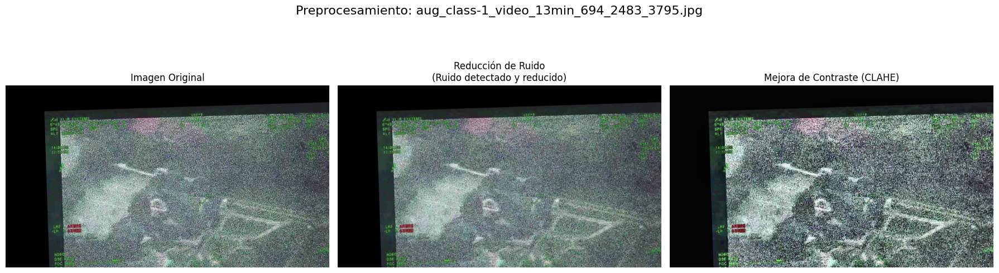

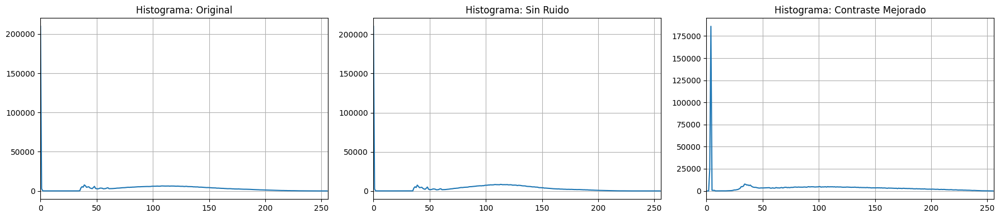

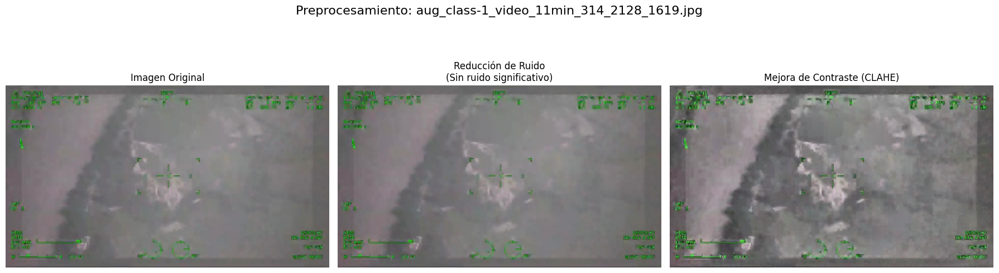

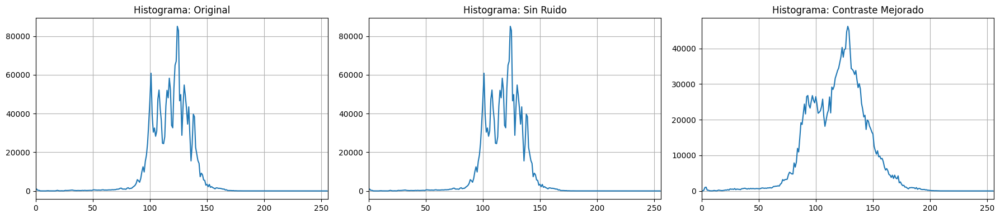

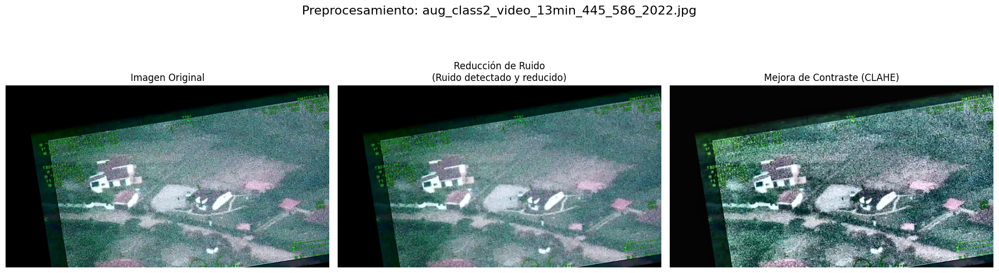

...

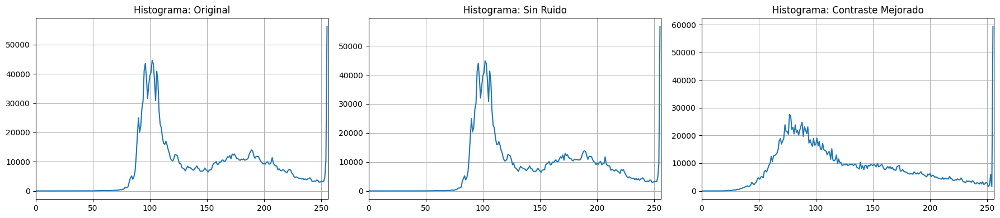

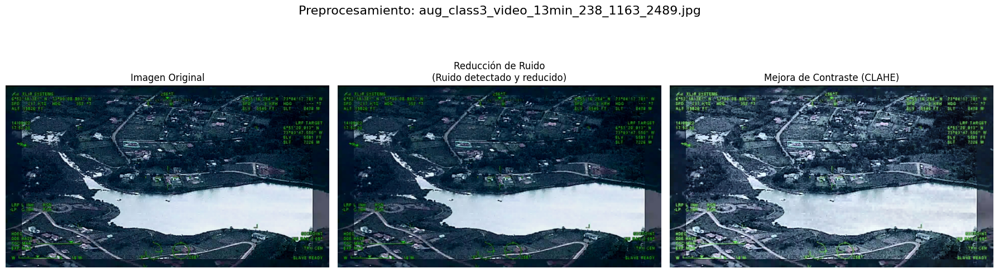

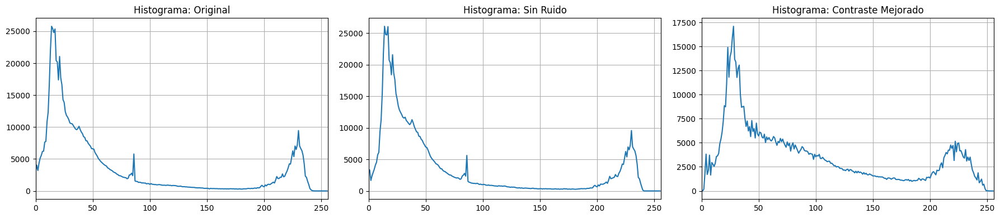

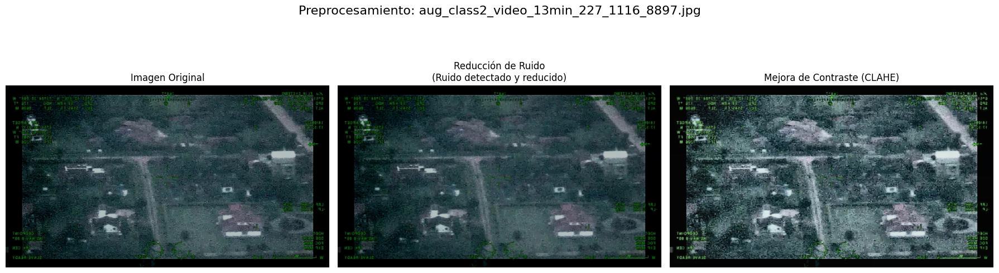

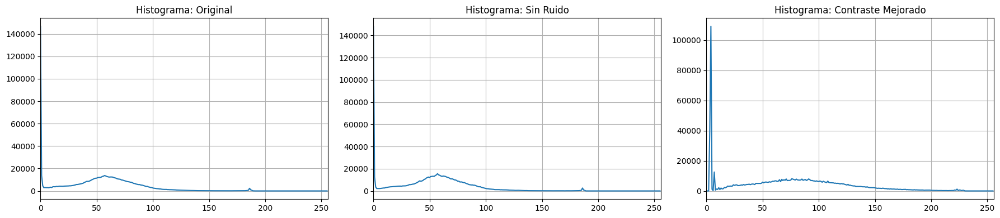

In [4]:
probar_preprocesamiento("modelo_yolov11_dataset_filtrado", num_imagenes=35)

# Separar imagenes

In [7]:
import cv2
import numpy as np
from pathlib import Path
import shutil
from tqdm import tqdm
import os

def reducir_ruido_sal_pimienta(imagen, umbral_deteccion=0.01, tamano_kernel=3):
    """
    Aplica filtro mediana solo si se detecta suficiente ruido sal y pimienta
    """
    # Convertir a escala de grises para análisis
    gris = cv2.cvtColor(imagen, cv2.COLOR_BGR2GRAY) if len(imagen.shape) > 2 else imagen.copy()
    
    # Detectar píxeles muy oscuros y muy brillantes (potencial ruido s&p)
    muy_oscuros = np.sum(gris < 30) / (gris.shape[0] * gris.shape[1])
    muy_brillantes = np.sum(gris > 225) / (gris.shape[0] * gris.shape[1])
    
    # Si hay suficientes píxeles extremos, aplicar filtro mediana
    if muy_oscuros + muy_brillantes > umbral_deteccion:
        if len(imagen.shape) > 2:  # Imagen a color
            resultado = cv2.medianBlur(imagen, tamano_kernel)
        else:  # Imagen en escala de grises
            resultado = cv2.medianBlur(imagen, tamano_kernel)
        return resultado, True
    
    return imagen, False

def mejorar_contraste_nubes(imagen, clip_limit=2.0, tile_grid_size=(8, 8)):
    """
    Mejora el contraste en imágenes con nubes mediante CLAHE
    """
    # Convertir a LAB para aplicar CLAHE solo en el canal L
    lab = cv2.cvtColor(imagen, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    
    # Aplicar CLAHE al canal L (luminosidad)
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)
    l_clahe = clahe.apply(l)
    
    # Combinar los canales de nuevo
    lab_clahe = cv2.merge((l_clahe, a, b))
    
    # Convertir de nuevo a BGR
    imagen_mejorada = cv2.cvtColor(lab_clahe, cv2.COLOR_LAB2BGR)
    
    return imagen_mejorada

def preprocesar_dataset(
    dataset_original_path, 
    output_path, 
    aplicar_filtro_ruido=True, 
    aplicar_mejora_contraste=True
):
    """
    Preprocesa todas las imágenes de un dataset y las guarda en una nueva ubicación
    
    Args:
        dataset_original_path: Ruta al dataset original
        output_path: Ruta donde guardar el dataset preprocesado
        aplicar_filtro_ruido: Si se debe aplicar el filtro de ruido
        aplicar_mejora_contraste: Si se debe aplicar la mejora de contraste
    """
    dataset_path = Path(dataset_original_path)
    output_path = Path(output_path)
    
    if not dataset_path.exists():
        raise FileNotFoundError(f"El dataset original no existe: {dataset_path}")
    
    # Crear directorios de salida si no existen
    output_path.mkdir(parents=True, exist_ok=True)
    
    # Copiar el archivo YAML de configuración si existe
    yaml_src = dataset_path / "dataset.yaml"
    if yaml_src.exists():
        shutil.copy(yaml_src, output_path / "dataset.yaml")
        print(f"✓ Copiado dataset.yaml")
    
    # Preprocesar cada conjunto (train, val, test)
    for split in ["train", "val", "test"]:
        img_src_dir = dataset_path / split / "images"
        lbl_src_dir = dataset_path / split / "labels"
        
        if not img_src_dir.exists():
            print(f"⚠️ El directorio de imágenes no existe: {img_src_dir}")
            continue
            
        img_out_dir = output_path / split / "images"
        lbl_out_dir = output_path / split / "labels"
        
        # Crear directorios de destino
        img_out_dir.mkdir(parents=True, exist_ok=True)
        lbl_out_dir.mkdir(parents=True, exist_ok=True)
        
        # Preprocesar imágenes
        all_images = list(img_src_dir.glob("*.jpg")) + list(img_src_dir.glob("*.jpeg")) + list(img_src_dir.glob("*.png"))
        print(f"🔍 Preprocesando {len(all_images)} imágenes en {split}...")
        
        stats = {"total": len(all_images), "ruido_detectado": 0}
        
        for img_path in tqdm(all_images):
            # Leer imagen
            img = cv2.imread(str(img_path))
            if img is None:
                print(f"⚠️ No se pudo leer la imagen: {img_path}")
                continue
            
            # Aplicar preprocesamiento
            if aplicar_filtro_ruido:
                img, ruido_detectado = reducir_ruido_sal_pimienta(img)
                if ruido_detectado:
                    stats["ruido_detectado"] += 1
            
            if aplicar_mejora_contraste:
                img = mejorar_contraste_nubes(img)
            
            # Guardar imagen preprocesada
            out_img_path = img_out_dir / img_path.name
            cv2.imwrite(str(out_img_path), img)
            
            # Copiar archivo de etiquetas correspondiente
            lbl_path = lbl_src_dir / f"{img_path.stem}.txt"
            if lbl_path.exists():
                out_lbl_path = lbl_out_dir / f"{img_path.stem}.txt"
                shutil.copy(lbl_path, out_lbl_path)
            else:
                # Si no hay etiqueta, crear un archivo vacío para representar fondo/background
                with open(lbl_out_dir / f"{img_path.stem}.txt", 'w') as f:
                    pass
        
        print(f"✓ Completado {split}: {stats['total']} imágenes procesadas, {stats['ruido_detectado']} con ruido detectado")
    
    print(f"\n✅ Preprocesamiento completado. Dataset guardado en: {output_path}")
    return output_path




In [8]:
preprocesar_dataset(
    "modelo_yolov11_dataset_completo", 
    "preprocesamiento/modelo_yolov11_dataset_completo_preprocesado",
    aplicar_filtro_ruido=True,
    aplicar_mejora_contraste=True
)

preprocesar_dataset(
    "modelo_yolov11_dataset_filtrado", 
    "preprocesamiento/modelo_yolov11_dataset_filtrado_preprocesado",
    aplicar_filtro_ruido=True,
    aplicar_mejora_contraste=True
)

✓ Copiado dataset.yaml
🔍 Preprocesando 8233 imágenes en train...


100%|██████████| 8233/8233 [11:38<00:00, 11.79it/s]


✓ Completado train: 8233 imágenes procesadas, 7830 con ruido detectado
🔍 Preprocesando 984 imágenes en val...


100%|██████████| 984/984 [01:22<00:00, 11.87it/s]


✓ Completado val: 984 imágenes procesadas, 937 con ruido detectado
🔍 Preprocesando 2424 imágenes en test...


100%|██████████| 2424/2424 [03:26<00:00, 11.74it/s]


✓ Completado test: 2424 imágenes procesadas, 2318 con ruido detectado

✅ Preprocesamiento completado. Dataset guardado en: preprocesamiento\modelo_yolov11_dataset_completo_preprocesado
✓ Copiado dataset.yaml
🔍 Preprocesando 8258 imágenes en train...


100%|██████████| 8258/8258 [11:56<00:00, 11.53it/s]


✓ Completado train: 8258 imágenes procesadas, 7842 con ruido detectado
🔍 Preprocesando 984 imágenes en val...


100%|██████████| 984/984 [01:20<00:00, 12.19it/s]


✓ Completado val: 984 imágenes procesadas, 937 con ruido detectado
🔍 Preprocesando 2416 imágenes en test...


100%|██████████| 2416/2416 [03:36<00:00, 11.17it/s]

✓ Completado test: 2416 imágenes procesadas, 2291 con ruido detectado

✅ Preprocesamiento completado. Dataset guardado en: preprocesamiento\modelo_yolov11_dataset_filtrado_preprocesado


WindowsPath('preprocesamiento/modelo_yolov11_dataset_filtrado_preprocesado')

# Entrenar modelo

In [9]:
from pathlib import Path
from sklearn.model_selection import KFold
from ultralytics import YOLO
from sklearn.model_selection import KFold
import shutil
from ultralytics import YOLO
import pandas as pd
import torch
torch.backends.cudnn.benchmark = True

In [11]:
from pathlib import Path

# Nombres de las clases (sin incluir background)
class_names = [
    "Vehiculos",
    "Bodegas",
    "Caminos",
    "Rios",
    "Zonas de mineria ilegal"
]

for dataset_name in ["preprocesamiento/modelo_yolov11_dataset_filtrado_preprocesado", "preprocesamiento/modelo_yolov11_dataset_completo_preprocesado"]:
    DATA_ROOT = Path(dataset_name)

    yaml_content = f"""\
        path: {DATA_ROOT.resolve()}
        train: train
        val: val
        test: test
        nc: {len(class_names)}
        names: {class_names}
        """


    yaml_path = DATA_ROOT / "dataset.yaml"
    with open(yaml_path, "w", encoding="utf-8") as f:
        f.write(yaml_content)

    print(f"✅ YAML generado en: {yaml_path}")


✅ YAML generado en: preprocesamiento\modelo_yolov11_dataset_filtrado_preprocesado\dataset.yaml
✅ YAML generado en: preprocesamiento\modelo_yolov11_dataset_completo_preprocesado\dataset.yaml


In [19]:

def entrenar_modelo_final(
    dataset_name: str,
    class_names: list,
    model_weights: str = "yolov8s.pt",
    epochs: int = 80,
    batch_size: int = 16,
    img_size: int = 640,
    patience: int = 10,
    output_name: str = "final_model",
):
    import re
    DATA_ROOT = Path(dataset_name)
    safe_name = re.sub(r"[^\w.-]", "_", output_name)
    FINAL_OUTPUT_DIR = Path(f"final_model_{safe_name}")
    FINAL_OUTPUT_DIR.mkdir(parents=True, exist_ok=True)

    yaml_path = DATA_ROOT / "dataset.yaml"
    run_name = f"{dataset_name}_final"
    project_dir = Path("runs/detect")
    best_ckpt = project_dir / run_name / "weights" / "best.pt"
    last_ckpt = project_dir / run_name / "weights" / "last.pt"

    # Lógica inteligente de carga
    if best_ckpt.exists():
        print(f"✅ Modelo final ya entrenado. Usando best.pt: {best_ckpt}")
        model = YOLO(str(best_ckpt))

    elif last_ckpt.exists():
        print(f"🔄 Reanudando entrenamiento desde last.pt: {last_ckpt}")
        model = YOLO(str(last_ckpt))
        model.train(resume=True, epochs=epochs, name=run_name)

        # Recarga best después de completar el entrenamiento
        model = YOLO(str(best_ckpt))

    else:
        print(f"🚀 Entrenando modelo final desde cero: {dataset_name}")
        model = YOLO(model_weights)
        model.train(
            data=str(yaml_path),
            epochs=epochs,
            imgsz=img_size,
            batch=batch_size,
            name=run_name,
            patience=patience
        )
        # Recarga best después de completar el entrenamiento
        model = YOLO(str(best_ckpt))

    # Guardado final
    final_model_path = FINAL_OUTPUT_DIR / "best_model_final.pt"
    model.save(str(final_model_path))
    print(f"\n✅ Modelo final guardado en: {final_model_path}")

# Filtrado

In [17]:
# Usando el dataset preprocesado
entrenar_modelo_final(
    dataset_name="preprocesamiento/modelo_yolov11_dataset_filtrado_preprocesado", 
    class_names=["Vehiculos", "Bodegas", "Caminos", "Rios", "Mineria ilegal"], 
    model_weights="yolov8s.pt", 
    epochs=80
)

✅ Modelo final ya entrenado. Usando best.pt: runs\detect\preprocesamiento\modelo_yolov11_dataset_filtrado_preprocesado_final\weights\best.pt

✅ Modelo final guardado en: final_model_preprocesamiento_modelo_yolov11_dataset_filtrado_preprocesado\best_model_final.pt


# Completo

In [18]:
entrenar_modelo_final(
    dataset_name="preprocesamiento/modelo_yolov11_dataset_completo_preprocesado", 
    class_names=["Vehiculos", "Bodegas", "Caminos", "Rios", "Mineria ilegal"], 
    model_weights="yolov8s.pt", 
    epochs=80
)

🚀 Entrenando modelo final desde cero: preprocesamiento/modelo_yolov11_dataset_completo_preprocesado
New https://pypi.org/project/ultralytics/8.3.139 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.121  Python-3.11.9 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 3060, 12288MiB)
engine\trainer: task=detect, mode=train, model=yolov8s.pt, data=preprocesamiento\modelo_yolov11_dataset_completo_preprocesado\dataset.yaml, epochs=80, time=None, patience=10, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=modelo_yolov11_dataset_completo_preprocesado_final, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=Fa

train: Scanning E:\Andes\11\Imagenes\FLIR_GPF2\preprocesamiento\modelo_yolov11_dataset_completo_preprocesado\train\labels... 8233 images, 2034 backgrounds, 0 corrupt: 100%|██████████| 8233/8233 [00:19<00:00, 424.57it/s]


train: New cache created: E:\Andes\11\Imagenes\FLIR_GPF2\preprocesamiento\modelo_yolov11_dataset_completo_preprocesado\train\labels.cache
val: Fast image access  (ping: 0.30.0 ms, read: 23.06.0 MB/s, size: 437.1 KB)


val: Scanning E:\Andes\11\Imagenes\FLIR_GPF2\preprocesamiento\modelo_yolov11_dataset_completo_preprocesado\val\labels... 984 images, 240 backgrounds, 0 corrupt: 100%|██████████| 984/984 [00:03<00:00, 312.71it/s]


val: New cache created: E:\Andes\11\Imagenes\FLIR_GPF2\preprocesamiento\modelo_yolov11_dataset_completo_preprocesado\val\labels.cache
Plotting labels to runs\detect\preprocesamiento\modelo_yolov11_dataset_completo_preprocesado_final\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: SGD(lr=0.01, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)


2025/05/19 06:50:05 INFO mlflow.tracking.fluent: Autologging successfully enabled for sklearn.
2025/05/19 06:50:05 INFO mlflow.tracking.fluent: Autologging successfully enabled for statsmodels.


MLflow: logging run_id(489dc78a926a490fb2e05a8ac7ddca1c) to runs\mlflow
MLflow: view at http://127.0.0.1:5000 with 'mlflow server --backend-store-uri runs\mlflow'
MLflow: disable with 'yolo settings mlflow=False'
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs\detect\preprocesamiento\modelo_yolov11_dataset_completo_preprocesado_final
Starting training for 80 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/80     0.918G      2.251      3.292      2.104         14        640: 100%|██████████| 515/515 [02:07<00:00,  4.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:07<00:00,  4.42it/s]

                   all        984       1154      0.418      0.402      0.363      0.136



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/80       3.7G      1.944      2.065        1.8         27        640: 100%|██████████| 515/515 [01:59<00:00,  4.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.49it/s]

                   all        984       1154      0.446      0.419      0.387      0.146



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/80       3.7G      1.965      2.031      1.789         35        640: 100%|██████████| 515/515 [01:57<00:00,  4.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.45it/s]


                   all        984       1154      0.381      0.449      0.373      0.149

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/80       3.7G      1.983      2.066      1.802         17        640: 100%|██████████| 515/515 [01:56<00:00,  4.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.49it/s]

                   all        984       1154      0.442      0.463      0.416       0.18



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/80       3.7G      1.902      1.922       1.74         34        640: 100%|██████████| 515/515 [01:58<00:00,  4.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:08<00:00,  3.60it/s]

                   all        984       1154      0.503      0.507      0.491      0.212



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/80       3.7G      1.827      1.809      1.695         17        640: 100%|██████████| 515/515 [01:58<00:00,  4.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.50it/s]

                   all        984       1154      0.485      0.561      0.515       0.25



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/80       3.7G      1.747      1.697      1.642         29        640: 100%|██████████| 515/515 [01:53<00:00,  4.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.76it/s]

                   all        984       1154      0.531      0.543      0.533      0.261



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/80       3.7G      1.695      1.611      1.591         14        640: 100%|██████████| 515/515 [01:52<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.76it/s]

                   all        984       1154      0.568      0.558      0.571      0.302



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/80       3.7G       1.62      1.518      1.544         10        640: 100%|██████████| 515/515 [01:58<00:00,  4.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.45it/s]


                   all        984       1154      0.616      0.614       0.64      0.358

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/80       3.7G      1.592       1.47      1.516         16        640: 100%|██████████| 515/515 [01:54<00:00,  4.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.48it/s]

                   all        984       1154      0.623      0.634      0.662      0.377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/80       3.7G      1.531       1.41      1.479         20        640: 100%|██████████| 515/515 [01:56<00:00,  4.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.63it/s]

                   all        984       1154      0.649      0.694       0.71      0.418



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/80       3.7G      1.512       1.35      1.461         24        640: 100%|██████████| 515/515 [01:54<00:00,  4.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.57it/s]

                   all        984       1154      0.658      0.667      0.696      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/80       3.7G      1.462      1.298      1.432         22        640: 100%|██████████| 515/515 [01:54<00:00,  4.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.55it/s]

                   all        984       1154      0.684       0.69      0.725      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/80       3.7G      1.428      1.253      1.398         32        640: 100%|██████████| 515/515 [01:54<00:00,  4.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.43it/s]

                   all        984       1154      0.668      0.719      0.712      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/80       3.7G        1.4       1.22      1.388         20        640: 100%|██████████| 515/515 [01:54<00:00,  4.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.60it/s]

                   all        984       1154      0.685      0.729      0.744      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/80       3.7G      1.389        1.2      1.371         35        640: 100%|██████████| 515/515 [01:54<00:00,  4.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.56it/s]

                   all        984       1154      0.674      0.729       0.75      0.475



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/80       3.7G      1.349      1.166      1.353         21        640: 100%|██████████| 515/515 [01:52<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.86it/s]


                   all        984       1154      0.681      0.745      0.754      0.487

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/80       3.7G       1.32      1.129       1.33         15        640: 100%|██████████| 515/515 [01:52<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.81it/s]

                   all        984       1154      0.715      0.711       0.76      0.491



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/80       3.7G      1.306      1.106      1.316         21        640: 100%|██████████| 515/515 [01:52<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.76it/s]


                   all        984       1154       0.75      0.706      0.768      0.513

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/80       3.7G       1.27      1.074      1.292         20        640: 100%|██████████| 515/515 [01:55<00:00,  4.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.76it/s]


                   all        984       1154      0.756      0.718      0.772      0.513

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/80       3.7G      1.263      1.063      1.296         21        640: 100%|██████████| 515/515 [01:52<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.81it/s]


                   all        984       1154      0.727      0.749      0.784      0.521

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/80       3.7G      1.238      1.034       1.28         27        640: 100%|██████████| 515/515 [01:52<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.83it/s]

                   all        984       1154      0.739      0.754      0.783      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/80       3.7G      1.226      1.005      1.267         22        640: 100%|██████████| 515/515 [01:52<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.85it/s]


                   all        984       1154      0.745      0.765      0.803      0.533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/80       3.7G      1.206     0.9954      1.253         28        640: 100%|██████████| 515/515 [01:52<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.86it/s]

                   all        984       1154      0.753      0.767      0.802      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/80       3.7G      1.178     0.9615      1.238         12        640: 100%|██████████| 515/515 [01:52<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.86it/s]

                   all        984       1154      0.725      0.812       0.81      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/80       3.7G      1.169     0.9502      1.236         25        640: 100%|██████████| 515/515 [01:53<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.75it/s]

                   all        984       1154      0.739      0.775      0.804      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/80       3.7G      1.149     0.9426      1.217         16        640: 100%|██████████| 515/515 [01:52<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.72it/s]

                   all        984       1154      0.769      0.763      0.809      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/80       3.7G      1.136     0.9209      1.212         20        640: 100%|██████████| 515/515 [01:52<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.72it/s]

                   all        984       1154      0.798      0.766      0.825      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/80       3.7G      1.122     0.9192      1.206         21        640: 100%|██████████| 515/515 [01:52<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.72it/s]

                   all        984       1154      0.792      0.766      0.816      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/80       3.7G      1.106     0.9036      1.195         26        640: 100%|██████████| 515/515 [01:52<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.75it/s]


                   all        984       1154      0.781      0.796      0.835      0.585

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/80       3.7G      1.095     0.8804      1.187         18        640: 100%|██████████| 515/515 [01:52<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.79it/s]

                   all        984       1154      0.786      0.801      0.835      0.589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/80       3.7G      1.083     0.8681      1.182         28        640: 100%|██████████| 515/515 [01:52<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.77it/s]


                   all        984       1154      0.794      0.787       0.83      0.588

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/80       3.7G      1.067     0.8571      1.175         30        640: 100%|██████████| 515/515 [01:52<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.83it/s]


                   all        984       1154      0.799      0.797       0.84      0.601

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/80       3.7G      1.065     0.8517      1.166         17        640: 100%|██████████| 515/515 [01:52<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.88it/s]

                   all        984       1154      0.794      0.817      0.841      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/80       3.7G      1.051     0.8374       1.16         23        640: 100%|██████████| 515/515 [01:55<00:00,  4.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.77it/s]

                   all        984       1154      0.801      0.796      0.847      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/80       3.7G       1.04     0.8266      1.155         18        640: 100%|██████████| 515/515 [01:52<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.79it/s]

                   all        984       1154      0.821      0.784      0.843      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/80       3.7G      1.029     0.8154       1.15         27        640: 100%|██████████| 515/515 [01:52<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.88it/s]


                   all        984       1154      0.816      0.781      0.842      0.614

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/80       3.7G       1.01     0.8104      1.141         27        640: 100%|██████████| 515/515 [01:52<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.84it/s]


                   all        984       1154      0.819      0.805      0.856      0.624

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/80       3.7G      1.002     0.7956      1.138         21        640: 100%|██████████| 515/515 [01:52<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.70it/s]

                   all        984       1154      0.799        0.8      0.856      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/80       3.7G     0.9863     0.7813      1.132         30        640: 100%|██████████| 515/515 [01:52<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.73it/s]


                   all        984       1154      0.809      0.814      0.858      0.632

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/80       3.7G     0.9703     0.7705      1.118         24        640: 100%|██████████| 515/515 [01:52<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.85it/s]

                   all        984       1154      0.802      0.799      0.853      0.636



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/80       3.7G     0.9724     0.7702      1.117          8        640: 100%|██████████| 515/515 [01:52<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.81it/s]


                   all        984       1154      0.797      0.815      0.851       0.64

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/80       3.7G     0.9506     0.7475      1.107         24        640: 100%|██████████| 515/515 [01:52<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.82it/s]

                   all        984       1154      0.788      0.817      0.853      0.651



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/80       3.7G      0.946     0.7493      1.102         18        640: 100%|██████████| 515/515 [01:52<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.89it/s]

                   all        984       1154      0.799      0.803      0.856      0.648



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/80       3.7G     0.9243     0.7236      1.092         20        640: 100%|██████████| 515/515 [01:52<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.92it/s]

                   all        984       1154      0.802      0.809      0.863      0.651



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/80       3.7G     0.9203     0.7287      1.091         18        640: 100%|██████████| 515/515 [01:52<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.88it/s]


                   all        984       1154      0.812      0.807       0.86      0.654

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/80       3.7G     0.9177      0.719      1.088         40        640: 100%|██████████| 515/515 [01:52<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.90it/s]

                   all        984       1154      0.818        0.8      0.863      0.655



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/80       3.7G      0.907     0.7075       1.08         24        640: 100%|██████████| 515/515 [01:52<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.91it/s]

                   all        984       1154      0.801      0.815      0.863      0.661



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/80       3.7G     0.8962     0.6941      1.076         16        640: 100%|██████████| 515/515 [01:52<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.94it/s]

                   all        984       1154      0.822      0.814      0.866       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/80       3.7G     0.8871     0.7022       1.07         34        640: 100%|██████████| 515/515 [01:55<00:00,  4.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.88it/s]

                   all        984       1154      0.823      0.818      0.869      0.664



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      51/80       3.7G     0.8723     0.6889      1.066         27        640: 100%|██████████| 515/515 [01:52<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.75it/s]

                   all        984       1154      0.824      0.814      0.866      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      52/80       3.7G     0.8682     0.6895      1.061         32        640: 100%|██████████| 515/515 [01:52<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.87it/s]

                   all        984       1154      0.803      0.822      0.864      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      53/80       3.7G     0.8593     0.6772      1.058         22        640: 100%|██████████| 515/515 [01:52<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.78it/s]


                   all        984       1154      0.811      0.814      0.867      0.676

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      54/80       3.7G     0.8481     0.6729       1.05         28        640: 100%|██████████| 515/515 [01:53<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.78it/s]


                   all        984       1154      0.803      0.833      0.873      0.671

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      55/80       3.7G     0.8525     0.6629      1.057         23        640: 100%|██████████| 515/515 [01:54<00:00,  4.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.83it/s]


                   all        984       1154       0.82      0.832      0.874      0.684

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      56/80       3.7G     0.8259     0.6557       1.04         22        640: 100%|██████████| 515/515 [01:52<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.88it/s]


                   all        984       1154      0.815       0.83      0.871      0.684

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      57/80       3.7G     0.8283     0.6473      1.043         18        640: 100%|██████████| 515/515 [01:53<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.93it/s]

                   all        984       1154      0.808      0.824      0.873      0.688



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      58/80       3.7G     0.8145     0.6382      1.038         24        640: 100%|██████████| 515/515 [01:52<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  5.02it/s]


                   all        984       1154      0.825       0.82      0.875      0.693

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      59/80       3.7G     0.8071     0.6333      1.025         23        640: 100%|██████████| 515/515 [01:52<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.97it/s]

                   all        984       1154      0.808      0.834      0.873      0.692



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      60/80       3.7G     0.7952     0.6321      1.028         35        640: 100%|██████████| 515/515 [01:52<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.94it/s]

                   all        984       1154        0.8      0.834       0.87      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      61/80       3.7G     0.7937      0.623      1.022         20        640: 100%|██████████| 515/515 [01:52<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.92it/s]

                   all        984       1154      0.814      0.837      0.875      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      62/80       3.7G     0.7808     0.6124      1.017         20        640: 100%|██████████| 515/515 [01:52<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.89it/s]


                   all        984       1154      0.818      0.841      0.879      0.698

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      63/80       3.7G     0.7684     0.6066      1.017         30        640: 100%|██████████| 515/515 [01:52<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.85it/s]

                   all        984       1154      0.815      0.846      0.882        0.7



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      64/80       3.7G     0.7674     0.6017      1.015         16        640: 100%|██████████| 515/515 [01:52<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.91it/s]

                   all        984       1154      0.807      0.841      0.879      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      65/80       3.7G     0.7582      0.596      1.009         26        640: 100%|██████████| 515/515 [01:55<00:00,  4.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.97it/s]


                   all        984       1154      0.807      0.844      0.879      0.704

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      66/80       3.7G     0.7476     0.5942      1.005         27        640: 100%|██████████| 515/515 [01:53<00:00,  4.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.92it/s]

                   all        984       1154      0.801       0.85      0.875      0.704



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      67/80       3.7G      0.729     0.5779     0.9951         18        640: 100%|██████████| 515/515 [01:52<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.96it/s]

                   all        984       1154       0.81      0.843      0.878      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      68/80       3.7G     0.7358     0.5813     0.9968         31        640: 100%|██████████| 515/515 [01:52<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.96it/s]

                   all        984       1154      0.811      0.845      0.878      0.708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      69/80       3.7G     0.7192     0.5785     0.9925         43        640: 100%|██████████| 515/515 [01:52<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.86it/s]

                   all        984       1154      0.824      0.829      0.877       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      70/80       3.7G     0.7113     0.5711     0.9889         17        640: 100%|██████████| 515/515 [01:52<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.86it/s]

                   all        984       1154      0.826       0.83      0.877      0.711


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      71/80       3.7G     0.6296     0.4876     0.9476         15        640: 100%|██████████| 515/515 [01:51<00:00,  4.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.82it/s]

                   all        984       1154       0.82      0.834      0.875      0.709



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      72/80       3.7G     0.5989     0.4717     0.9327          5        640: 100%|██████████| 515/515 [01:51<00:00,  4.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.88it/s]

                   all        984       1154      0.815      0.845      0.876       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      73/80       3.7G     0.5876     0.4591     0.9283          7        640: 100%|██████████| 515/515 [01:51<00:00,  4.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.84it/s]

                   all        984       1154      0.823      0.839      0.878      0.711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      74/80       3.7G     0.5696     0.4539     0.9186          8        640: 100%|██████████| 515/515 [01:52<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.85it/s]

                   all        984       1154      0.812      0.835      0.876      0.712



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      75/80       3.7G     0.5652     0.4459     0.9168         11        640: 100%|██████████| 515/515 [01:51<00:00,  4.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.85it/s]

                   all        984       1154      0.816      0.844      0.877      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      76/80       3.7G     0.5493      0.439     0.9111         12        640: 100%|██████████| 515/515 [01:51<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.85it/s]

                   all        984       1154      0.826      0.828      0.875      0.717



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      77/80       3.7G     0.5428     0.4373     0.9115          9        640: 100%|██████████| 515/515 [01:51<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.81it/s]


                   all        984       1154      0.836      0.822      0.877      0.716

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      78/80       3.7G     0.5293     0.4261     0.9052          6        640: 100%|██████████| 515/515 [01:51<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.97it/s]

                   all        984       1154      0.835      0.827      0.877      0.717



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      79/80       3.7G     0.5217     0.4211     0.9018          9        640: 100%|██████████| 515/515 [01:51<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.88it/s]

                   all        984       1154      0.824      0.835      0.878      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      80/80       3.7G     0.5146     0.4174     0.9009          7        640: 100%|██████████| 515/515 [01:54<00:00,  4.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.85it/s]

                   all        984       1154      0.822      0.837      0.877       0.72



80 epochs completed in 2.691 hours.
Optimizer stripped from runs\detect\preprocesamiento\modelo_yolov11_dataset_completo_preprocesado_final\weights\last.pt, 22.5MB
Optimizer stripped from runs\detect\preprocesamiento\modelo_yolov11_dataset_completo_preprocesado_final\weights\best.pt, 22.5MB

Validating runs\detect\preprocesamiento\modelo_yolov11_dataset_completo_preprocesado_final\weights\best.pt...
Ultralytics 8.3.121  Python-3.11.9 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 3060, 12288MiB)
Model summary (fused): 72 layers, 11,127,519 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:06<00:00,  4.46it/s]


                   all        984       1154      0.821      0.837      0.877      0.719
             Vehiculos        234        241      0.857          1      0.936      0.927
               Bodegas         66        256      0.601      0.613      0.656      0.347
               Caminos        138        230      0.818      0.799      0.878      0.593
                  Rios        135        209      0.885      0.922      0.956      0.787
Zonas de mineria ilegal        206        218      0.945      0.849      0.958      0.943
Speed: 0.1ms preprocess, 1.9ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to runs\detect\preprocesamiento\modelo_yolov11_dataset_completo_preprocesado_final
MLflow: results logged to runs\mlflow
MLflow: disable with 'yolo settings mlflow=False'

✅ Modelo final guardado en: final_model_preprocesamiento_modelo_yolov11_dataset_completo_preprocesado\best_model_final.pt
